# Clinical Trial Analysis for Indiana

The purpose of this project is to gather data about clinical trials that have been conducted in the state of Indiana in order to make a determination about the level of trial activity in the state, how it compares to other states, and the nature of the trials. The goal is to understand where Indiana ranks, what areas we may be able to target for improvement and to get a general sense of the distribution of trial activity across the country as a whole.

In [ ]:
# # If running on local machine:
# !pip install numpy
# !pip install pandas
# !pip install uszipcode
# !pip install python-Levenshtein
# !pip install geopy
# !pip install folium
# !pip install sklearn
# !pip install seaborn
# !pip install plotly
# !pip install --upgrade nbformat
# !pip install ipykernel
# !pip install "jupyterlab>=3" "ipywidgets>=7.6"
# !pip install addfips
# !pip install geocoder
# !pip install us
# !pip install pgeocode

In [1]:

import numpy as np
import pandas as pd
from uszipcode import SearchEngine, SimpleZipcode, ComprehensiveZipcode
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
from io import StringIO
from geopy.geocoders import Nominatim
import matplotlib.cm as cm
import matplotlib.colors as colors
import folium
import pickle
import re
import warnings
import time
warnings.filterwarnings('ignore')

pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 800)

In [2]:

#save pickle files for variables
def save(filename, *args):
    # Get global dictionary
    glob = globals()
    d = {}
    for v in args:
        # Copy over desired values
        d[v] = glob[v]
    with open(filename, 'wb') as f:
        # Put them in the file 
        pickle.dump(d, f)

def load_pickle(filename):
    # Get global dictionary
    glob = globals()
    with open(filename, 'rb') as f:
        for k, v in pickle.load(f).items():
            # Set each global variable to the value from the file
            glob[k] = v

## Loading the data sources

1. The CSV file loaded below is the main data source for this project and was downloaded from clinicaltrials.gov by filtering for locations in the United States and including all available columns. This particular file was downloaded in November 2023. After loading the datasets below we will process the data to create a multifaceted dataset for analysis.

In [9]:
# Due to it's size, this file could not be shared on github, but updated file can be attained from https://www.clinicaltrials.gov/
# for this project we downloaded the full dataset by selecting "All studies" with no filtering.
csv_path='clinical_trial_int.csv'
NIH_usa_orig = pd.read_csv(csv_path)

In [74]:
print(NIH_usa_orig.shape)
NIH_usa_orig.head()


(471599, 30)


,NCT Number,Study Title,Study URL,Acronym,Study Status,Brief Summary,Study Results,Conditions,Interventions,Primary Outcome Measures,Secondary Outcome Measures,Other Outcome Measures,Sponsor,Collaborators,Sex,Age,Phases,Enrollment,Funder Type,Study Type,Study Design,Other IDs,Start Date,Primary Completion Date,Completion Date,First Posted,Results First Posted,Last Update Posted,Locations,Study Documents
0,NCT04951271,Anger Management and Violent Behavior in Adole...,https://clinicaltrials.gov/study/NCT04951271,NaN,COMPLETED,The research was conducted to examine the effe...,NO,Adolescent|Anger|Violent Behavior,BEHAVIORAL: Solution focused approach,Trait Anger and Anger Expression level in adol...,NaN,NaN,Pamukkale University,NaN,ALL,"CHILD, ADULT, OLDER_ADULT",NaN,48.0,OTHER,INTERVENTIONAL,Allocation: RANDOMIZED|Intervention Model: PAR...,"Adolescent, anger management",2020-01-15,2020-01-15,2020-04-15,2021-07-06,NaN,2021-08-02,"Pamukkale University, Denizli, Kınıklı Campus,...",NaN
1,NCT03630471,Effectiveness of a Problem-solving Interventio...,https://clinicaltrials.gov/study/NCT03630471,PRIDE,COMPLETED,We will conduct a two-arm individually randomi...,NO,"Mental Health Issue (E.G., Depression, Psychos...",BEHAVIORAL: PRIDE 'Step 1' problem-solving int...,"Mental health symptoms, The Strengths and Diff...","Mental health symptoms, The adolescent-reporte...",NaN,Sangath,Harvard Medical School (HMS and HSDM)|London S...,ALL,"CHILD, ADULT",NaN,250.0,OTHER,INTERVENTIONAL,Allocation: RANDOMIZED|Intervention Model: PAR...,SANPRIDE_002,2018-08-20,2019-01-20,2019-02-28,2018-08-14,NaN,2019-05-21,"Sangath, New Delhi, Delhi, 110016, India",Statistical Analysis Plan
2,NCT05843071,PMCF Study to Evaluate Performance and Safety ...,https://clinicaltrials.gov/study/NCT05843071,NaN,RECRUITING,"Acute viral upper respiratory tract infection,...",NO,Nasal Congestion|Nasal Dryness,DEVICE: Nasal sprays with sea salts,Change in nasal symptoms:To evaluate the perfo...,To evaluate the safety and tolerability of the...,NaN,C.O.C. Farmaceutici S.r.l.,NaN,ALL,"CHILD, ADULT, OLDER_ADULT",NaN,105.0,INDUSTRY,INTERVENTIONAL,Allocation: NA|Intervention Model: SINGLE_GROU...,COC-R8-NS,2022-09-01,2023-06-15,2023-06-15,2023-05-06,NaN,2023-05-06,"U.O.C otorinolaringoiatria, Policlinico Mater ...",NaN
3,NCT01125371,Computerized Brief Alcohol Intervention (BI) f...,https://clinicaltrials.gov/study/NCT01125371,NaN,COMPLETED,African American (AA) women are disproportiona...,YES,Alcohol; Harmful Use|Binge Drinking|Risk Behav...,BEHAVIORAL: Computerized brief alcohol interve...,"Change in Alcohol Use (Heavy Drinking Days), C...",NaN,NaN,Johns Hopkins University,National Institute on Alcohol Abuse and Alcoho...,FEMALE,"ADULT, OLDER_ADULT",NaN,439.0,OTHER,INTERVENTIONAL,Allocation: RANDOMIZED|Intervention Model: PAR...,NIAAAGC018632|R01AA018632,2011-10,2016-06-07,2016-06-07,2010-05-18,2022-06-01,2022-06-24,"Baltimore City Health Department STD Clinic, B...",Study Protocol and Statistical Analysis Plan
4,NCT02554071,Manitoba Pharmacist Initiated Smoking Cessatio...,https://clinicaltrials.gov/study/NCT02554071,NaN,COMPLETED,A single arm pilot study conducted to assess t...,NO,Smoking Cessation,OTHER: Pharmacist - Smoking Cessation Support,"Smoking Cessation Assessment, Self-reported Sm...","Smoking Cessation Assessment, Self-reported Sm...","Cigarettes Smoked, # of cigarettes smoked, day...",University of Manitoba,Govenment of Manitoba|Canadian Foundation for ...,ALL,"ADULT, OLDER_ADULT",PHASE4,119.0,OTHER,INTERVENTIONAL,Allocation: NA|Intervention Model: SINGLE_GROU...,H2013:459,2014-01,2014-11,2014-11,2015-09-18,NaN,2015-09-18,"College of Pharmacy, University of Manitoba, W...",NaN


2. In order to understand the representation of urban and rural areas in the clinical trial data, the following dataset was created using selected columns from the US Census. More details about the data available here: https://www.census.gov/programs-surveys/geography/guidance/geo-areas/urban-rural.html

In [10]:
csv_path='urban_2020.csv'
urb_rur = pd.read_csv(csv_path)

In [76]:
print(urb_rur.shape)
urb_rur.head()

(1045372, 10)


,STATE,COUNTY,STATE_NAME,COUNTY_NAME,POP_COU,POPDEN_COU,POP_URB,POPPCT_URB,POP_RUR,POPPCT_RUR
0,1.0,1.0,Alabama,Autauga,"58,805",98.92,"34,885",59.32%,"23,920",40.68%
1,1.0,3.0,Alabama,Baldwin,"231,767",145.78,"144,654",62.41%,"87,113",37.59%
2,1.0,5.0,Alabama,Barbour,"25,223",28.50,"8,596",34.08%,"16,627",65.92%
3,1.0,7.0,Alabama,Bibb,"22,293",35.81,0,0.00%,"22,293",100.00%
4,1.0,9.0,Alabama,Blount,"59,134",91.70,"5,624",9.51%,"53,510",90.49%


3. The next data source was a list of hospitals for the United States which was from the Centers for Medicare and Medicaid Services.

In [83]:
csv_path='Hospital_list_CMS.csv'
hospitals_us = pd.read_csv(csv_path)

In [84]:
print(hospitals_us.shape)
hospitals_us.head()

(5446, 38)


,Facility ID,Facility Name,Address,City/Town,State,ZIP Code,County/Parish,Telephone Number,Hospital Type,Hospital Ownership,Emergency Services,Meets criteria for promoting interoperability of EHRs,Hospital overall rating,Hospital overall rating footnote,MORT Group Measure Count,Count of Facility MORT Measures,Count of MORT Measures Better,Count of MORT Measures No Different,Count of MORT Measures Worse,MORT Group Footnote,Safety Group Measure Count,Count of Facility Safety Measures,Count of Safety Measures Better,Count of Safety Measures No Different,Count of Safety Measures Worse,Safety Group Footnote,READM Group Measure Count,Count of Facility READM Measures,Count of READM Measures Better,Count of READM Measures No Different,Count of READM Measures Worse,READM Group Footnote,Pt Exp Group Measure Count,Count of Facility Pt Exp Measures,Pt Exp Group Footnote,TE Group Measure Count,Count of Facility TE Measures,TE Group Footnote
0,010001,SOUTHEAST HEALTH MEDICAL CENTER,1108 ROSS CLARK CIRCLE,DOTHAN,AL,36301,HOUSTON,(334) 793-8701,Acute Care Hospitals,Government - Hospital District or Authority,Yes,Y,3,NaN,7,7,1,5,1,NaN,8,8,2,6,0,NaN,11,11,0,10,1,NaN,8,8,NaN,12,10,NaN
1,010005,MARSHALL MEDICAL CENTERS,2505 U S HIGHWAY 431 NORTH,BOAZ,AL,35957,MARSHALL,(256) 593-8310,Acute Care Hospitals,Government - Hospital District or Authority,Yes,Y,2,NaN,7,6,0,4,2,NaN,8,7,0,6,1,NaN,11,10,0,10,0,NaN,8,8,NaN,12,11,NaN
2,010006,NORTH ALABAMA MEDICAL CENTER,1701 VETERANS DRIVE,FLORENCE,AL,35630,LAUDERDALE,(256) 629-1000,Acute Care Hospitals,Proprietary,Yes,Y,1,NaN,7,7,0,5,2,NaN,8,7,2,5,0,NaN,11,9,0,7,2,NaN,8,8,NaN,12,11,NaN
3,010007,MIZELL MEMORIAL HOSPITAL,702 N MAIN ST,OPP,AL,36467,COVINGTON,(334) 493-3541,Acute Care Hospitals,Voluntary non-profit - Private,Yes,Y,2,NaN,7,3,0,3,0,NaN,8,2,0,2,0,NaN,11,6,0,5,1,NaN,8,8,NaN,12,7,NaN
4,010008,CRENSHAW COMMUNITY HOSPITAL,101 HOSPITAL CIRCLE,LUVERNE,AL,36049,CRENSHAW,(334) 335-3374,Acute Care Hospitals,Proprietary,Yes,Y,Not Available,16.0,7,1,0,1,0,NaN,8,Not Available,Not Available,Not Available,Not Available,5.0,11,2,0,2,0,NaN,8,Not Available,5.0,12,6,NaN


4. In order to generate maps we need to be able to verify zipcodes and add geocode (latitude and longitude) coordinates based on the zipcodes. In order to be as inclusive as possible we use the 3 zip lists below at different points in the code.

In [3]:
# data source: https://www.stats.indiana.edu/maptools/zips-by-county-2021.xlsx
csv_path='zips-by-county-2021.csv'
IN_zipcodes = pd.read_csv(csv_path)

In [4]:
#zip source: https://simplemaps.com/data/us-zips
import chardet

with open('uszips.csv', 'rb') as f:
    result = chardet.detect(f.read())  # or readline if the file is large


all_zips = pd.read_csv('uszips.csv', encoding=result['encoding'])


In [47]:
print(all_zips.shape)
all_zips.head()

(33788, 18)


,zip,lat,lng,city,state_id,state_name,zcta,parent_zcta,population,density,county_fips,county_name,county_weights,county_names_all,county_fips_all,imprecise,military,timezone
0,601,18.18027,-66.75266,Adjuntas,PR,Puerto Rico,True,NaN,17126.0,102.6,72001,Adjuntas,"{""72001"": 98.73, ""72141"": 1.27}",Adjuntas|Utuado,72001|72141,False,False,America/Puerto_Rico
1,602,18.36075,-67.17541,Aguada,PR,Puerto Rico,True,NaN,37895.0,482.5,72003,Aguada,"{""72003"": 100}",Aguada,72003,False,False,America/Puerto_Rico
2,603,18.45744,-67.12225,Aguadilla,PR,Puerto Rico,True,NaN,49136.0,552.4,72005,Aguadilla,"{""72005"": 99.76, ""72099"": 0.24}",Aguadilla|Moca,72005|72099,False,False,America/Puerto_Rico
3,606,18.16585,-66.93716,Maricao,PR,Puerto Rico,True,NaN,5751.0,50.1,72093,Maricao,"{""72093"": 82.27, ""72153"": 11.66, ""72121"": 6.06}",Maricao|Yauco|Sabana Grande,72093|72153|72121,False,False,America/Puerto_Rico
4,610,18.29110,-67.12243,Anasco,PR,Puerto Rico,True,NaN,26153.0,272.1,72011,Añasco,"{""72011"": 96.7, ""72099"": 2.81, ""72083"": 0.37, ...",Añasco|Moca|Las Marías|Aguada,72011|72099|72083|72003,False,False,America/Puerto_Rico


In [5]:
engine = SearchEngine()
allzips = {}
for i in range(100000): #Get zipcode info for every possible 5-digit combination
    zipcode = str(i).zfill(5)
    try: allzips[zipcode] = engine.by_zipcode(zipcode).to_dict()
    except: pass
#Convert dictionary to DataFrame
allzips = pd.DataFrame(allzips).T.reset_index(drop = True)

In [48]:
print(allzips.shape)
allzips.head()

(42724, 24)


,zipcode,zipcode_type,major_city,post_office_city,common_city_list,county,state,lat,lng,timezone,radius_in_miles,area_code_list,population,population_density,land_area_in_sqmi,water_area_in_sqmi,housing_units,occupied_housing_units,median_home_value,median_household_income,bounds_west,bounds_east,bounds_north,bounds_south
0,00501,UNIQUE,Holtsville,None,[Holtsville],Suffolk County,NY,40.81,-73.04,America/New_York,None,631,None,None,None,None,None,None,None,None,None,None,None,None
1,00544,UNIQUE,Holtsville,None,[Holtsville],Suffolk County,NY,40.81,-73.04,America/New_York,None,631,None,None,None,None,None,None,None,None,None,None,None,None
2,00601,STANDARD,Adjuntas,None,[Adjuntas],Adjuntas Municipio,PR,18.16,-66.72,America/Puerto_Rico,None,"787,939",None,None,None,None,None,None,None,None,None,None,None,None
3,00602,STANDARD,Aguada,"Aguada, PR",[Aguada],Aguada Municipio,PR,18.38,-67.18,America/Puerto_Rico,4.0,"787,939",None,None,None,None,None,None,None,None,-67.240437,-67.126434,18.417478,18.312691
4,00603,STANDARD,Aguadilla,"Aguadilla, PR","[Aguadilla, Ramey]",Aguadilla Municipio,PR,18.43,-67.15,America/Puerto_Rico,5.0,787,None,None,None,None,None,None,None,None,-67.16943,-67.056404,18.513195,18.385925


## Building the dataset and cleaning.

The following steps are taken in the sections below to build out the dataset:
1. Select columns needed from the original dataset.
2. Extract and separate zip codes from the locations column of the dataset (dropping those rows without zip codes.)
3. Create column for state names for all zips in the location column.
4. Create column for county names for all zips in the location column.
5. Add FIPS code for the counties so that we can merge with US Census data.
6. Add a column for the percentage of each County population living in rural areas.

In [13]:
NIH_usa_orig.columns

Index(['NCT Number', 'Study Title', 'Study URL', 'Acronym', 'Study Status', 'Brief Summary', 'Study Results', 'Conditions', 'Interventions', 'Primary Outcome Measures', 'Secondary Outcome Measures', 'Other Outcome Measures', 'Sponsor', 'Collaborators', 'Sex', 'Age', 'Phases', 'Enrollment', 'Funder Type', 'Study Type', 'Study Design', 'Other IDs', 'Start Date', 'Primary Completion Date', 'Completion Date', 'First Posted', 'Results First Posted', 'Last Update Posted', 'Locations', 'Study Documents'], dtype='object')

In [84]:
NIH_usa = NIH_usa_orig[['Locations', 'Funder Type', 'Sponsor', 'Phases', 'Conditions', 'Interventions', 'Brief Summary', 'Study Status', 'NCT Number', 'Start Date', 'First Posted', 'Completion Date', 'Sex', 'Age']]

NIH_usa['Locations'] = NIH_usa['Locations'].fillna('11111')
print(NIH_usa.shape)

(471599, 14)


In [85]:
def extract_and_separate_zip(location):
    zip_code_pattern = r'\b\d{5}\b'  # Regular expression pattern for 5-digit zip codes

    zip_codes = re.findall(zip_code_pattern, location)
    if zip_codes:
        return ', '.join(zip_codes)
    else:
        return None

# Apply the function to the 'Location' column
NIH_usa['Zip_Codes'] = NIH_usa['Locations'].apply(extract_and_separate_zip)

In [86]:
nan_nih = NIH_usa[NIH_usa['Zip_Codes'].isna()]
print(NIH_usa.shape)
print(nan_nih.shape)
NIH_usa.dropna(subset=['Zip_Codes'], inplace=True)
print(NIH_usa.shape)

(471599, 15)
(167772, 15)
(303827, 15)


We'll use the US zipcode python library to create a column out of the locations for zipcodes and we can use that to add county names so we can understand the geographic distribution of the trials.

In [87]:
search = SearchEngine()

def get_state_name(zip_code):
    if not zip_code:  # Handle empty or None values in the 'Zip_Codes' column
        return 'Unknown'

    # Split the zip codes by comma and remove any leading/trailing spaces
    zip_codes = [z.strip() for z in zip_code.split(',')]

    state_names = []
    for z in zip_codes:
        result = search.by_zipcode(z)
        if result:
            state_names.append(result.state)
        else:
            state_names.append('Unknown')

    return ', '.join(state_names)

NIH_usa['State'] = NIH_usa['Zip_Codes'].apply(get_state_name)

In [91]:
def get_county_name(zip_code):
    if not zip_code:  # Handle empty or None values in the 'Zip_Codes' column
        return 'Unknown'

    # Split the zip codes by comma and remove any leading/trailing spaces
    zip_codes = [z.strip() for z in zip_code.split(',')]

    county_names = []
    for z in zip_codes:
        result = search.by_zipcode(z)
        if result:
            county1 = result.county
            state1 = result.state
            county_names.append(county1+' '+state1)
        else:
            county_names.append('Unknown')

    return ', '.join(county_names)


NIH_usa['County'] = NIH_usa['Zip_Codes'].apply(get_county_name)

In [92]:
nan_nih = NIH_usa[NIH_usa['Zip_Codes'].isna()]
print(nan_nih.shape)

(0, 17)


In order to connect the data with the US Census we need to include FIPS unique identifier codes for each of the counties.

In [93]:
import addfips
af = addfips.AddFIPS()
# zip_df = pd.DataFrame(list(zip_dict.items()), columns=['Zip Code', 'County'])

def add_fips_row(df):
    df['COUNTY_FIPS']= None
    for index, row in df.iterrows():
        fips = []
        county_names = row['County'].split(', ')
        for c in county_names:
            fip_code = af.get_county_fips(str(c)[:-3], str(c)[-2:])
            fips.append(fip_code)
        df.at[index, 'COUNTY_FIPS'] = fips
    df['COUNTY_FIPS'] = df['COUNTY_FIPS'].apply(lambda x: x if x else None)
    return df
    
NIH_usa = add_fips_row(NIH_usa)

In [11]:
# 
urb_rur['COUNTY'] = urb_rur['COUNTY'].astype(str).str.replace(r'\.0$', '', regex=True)
urb_rur['STATE'] = urb_rur['STATE'].astype(str).str.replace(r'\.0$', '', regex=True)
urb_rur['COUNTY'] = urb_rur['COUNTY'].astype(str).str.zfill(3)
urb_rur['STATE'] = urb_rur['STATE'].astype(str).str.zfill(2)
urb_rur['COUNTY_FIPS'] = urb_rur['STATE']+urb_rur['COUNTY']
urb_rur.head()

,STATE,COUNTY,STATE_NAME,COUNTY_NAME,POP_COU,POPDEN_COU,POP_URB,POPPCT_URB,POP_RUR,POPPCT_RUR,COUNTY_FIPS
0,01,001,Alabama,Autauga,"58,805",98.92,"34,885",59.32%,"23,920",40.68%,01001
1,01,003,Alabama,Baldwin,"231,767",145.78,"144,654",62.41%,"87,113",37.59%,01003
2,01,005,Alabama,Barbour,"25,223",28.50,"8,596",34.08%,"16,627",65.92%,01005
3,01,007,Alabama,Bibb,"22,293",35.81,0,0.00%,"22,293",100.00%,01007
4,01,009,Alabama,Blount,"59,134",91.70,"5,624",9.51%,"53,510",90.49%,01009


Below we create a merged dataframe bringing the total populations for each county that is represented in the trial locations along with the total population residing in a rural area according to the US Census from 2020. In the following cell we will regroup the rows by the NCT Number for each trial and sum the county total populations and total rural populations so that we can create a new feature indicating the overall rural population percentage for each trial. This can help us understand the potential urban/ rural proportions among the locations included in each trial to compare the trial locations for the US against those held in Indiana.

In [95]:
agg_functions = {
    'COUNTY_FIPS': lambda x: list(x),
    'POP_COU': 'sum',
    'POP_RUR': 'sum'
}

def add_rur_pct(nih_df):
    rur_select = urb_rur[['COUNTY_FIPS','POP_COU','POP_RUR']]
    NIH_select = nih_df[['NCT Number','COUNTY_FIPS']]
    NIH_select = NIH_select.explode('COUNTY_FIPS', ignore_index=True)
    NIH_select.dropna(subset=['COUNTY_FIPS'], inplace=True)
    NIH_rur = pd.merge(NIH_select, rur_select, how='left', on='COUNTY_FIPS')
    try:
        NIH_rur['POP_COU'] = pd.to_numeric(NIH_rur['POP_COU'].str.replace(',', ''))
        NIH_rur['POP_RUR'] = pd.to_numeric(NIH_rur['POP_RUR'].str.replace(',', ''))
    except:
        pass
    NIH_rur = NIH_rur.groupby('NCT Number').agg(agg_functions).reset_index()
    NIH_rur['Loc_County_rural_pct'] = round(NIH_rur['POP_RUR']/NIH_rur['POP_COU'],4)*100
    nih_df = nih_df.merge(NIH_rur[['NCT Number','Loc_County_rural_pct']], on= 'NCT Number', how = 'left')
    return nih_df

In [96]:
NIH_usa = add_rur_pct(NIH_usa)
print(NIH_usa.shape)

(303827, 19)


In [97]:
NIH_usa.isnull().sum()

Locations                    0
Funder Type                889
Sponsor                      0
Phases                  177693
Conditions                 920
Interventions            30087
Brief Summary              889
Study Status                 0
NCT Number                   0
Start Date                4322
First Posted                 0
Completion Date          12079
Sex                       1270
Age                        889
Zip_Codes                    0
State                        0
County                       0
COUNTY_FIPS                  0
Loc_County_rural_pct     95413
dtype: int64

In [98]:
save('backup', 'NIH_usa')

In [3]:
load_pickle('backup')

In [26]:
NIH_usa.to_csv(r'./NIH_usa.csv', index = False)

In [27]:
# csv_path='NIH_usa.csv'
# NIH_usa = pd.read_csv(csv_path)
# print(NIH_usa.shape)
# # NIH_usa.head()

In [4]:
NIH_usa.head()

,Locations,Funder Type,Sponsor,Phases,Conditions,Interventions,Brief Summary,Study Status,NCT Number,Start Date,First Posted,Completion Date,Sex,Age,Zip_Codes,State,County,COUNTY_FIPS,Loc_County_rural_pct
0,"Pamukkale University, Denizli, Kınıklı Campus,...",OTHER,Pamukkale University,NaN,Adolescent|Anger|Violent Behavior,BEHAVIORAL: Solution focused approach,The research was conducted to examine the effe...,COMPLETED,NCT04951271,2020-01-15,2021-07-06,2020-04-15,ALL,"CHILD, ADULT, OLDER_ADULT",20160,VA,Loudoun County VA,[51107],11.95
1,"U.O.C otorinolaringoiatria, Policlinico Mater ...",INDUSTRY,C.O.C. Farmaceutici S.r.l.,NaN,Nasal Congestion|Nasal Dryness,DEVICE: Nasal sprays with sea salts,"Acute viral upper respiratory tract infection,...",RECRUITING,NCT05843071,2022-09-01,2023-05-06,2023-06-15,ALL,"CHILD, ADULT, OLDER_ADULT",88100,Unknown,Unknown,[None],NaN
2,"Baltimore City Health Department STD Clinic, B...",OTHER,Johns Hopkins University,NaN,Alcohol; Harmful Use|Binge Drinking|Risk Behav...,BEHAVIORAL: Computerized brief alcohol interve...,African American (AA) women are disproportiona...,COMPLETED,NCT01125371,2011-10,2010-05-18,2016-06-07,FEMALE,"ADULT, OLDER_ADULT",21205,MD,Baltimore city MD,[24510],0.00
3,"Children's Hospital, Colorado, Aurora, Colorad...",OTHER,"University of Colorado, Denver",NaN,Hyperhidrosis,DRUG: Oxybutynin 3% gel,"This is a single-center, prospective, open-lab...",COMPLETED,NCT02633371,2016-02,2015-12-17,2017-05,ALL,"CHILD, ADULT",80045,CO,Adams County CO,[08001],4.04
4,"Mount Sinai-Beth Israel Medical Center, New Yo...",OTHER,King's College London,NaN,Juvenile Myoclonic Epilepsy,OTHER: Blood draw|OTHER: Existing samples,The investigators are collecting genetic infor...,RECRUITING,NCT03400371,2017-07-13,2018-01-17,2026-06-30,ALL,"CHILD, ADULT","10003, 10025, 43125, 13419, 75019, 00198","NY, NY, OH, Unknown, TX, Unknown","New York County NY, New York County NY, Frankl...","[36061, 36061, 39049, None, 48113, None]",0.45


## Create a list of NIH Registered Clinical Trials for Indiana

Here we will create our list of trials in Indiana. We will use a more detailed dataset of zipcodes for Indiana to make sure we are including all trials.

In [61]:
#create zip list for IN
print(len(IN_zipcodes))
zip_list = IN_zipcodes['ZIP_CODE']
zip_list = [str(zip) for zip in zip_list]
print(len(zip_list))

1292
1292


In [74]:
# filter for IN and only keep IN zipcodes:
NIH_in = NIH_usa[NIH_usa['State'].str.contains('IN')]

def filter_zip_codes(zip_codes):
    return [code for code in zip_codes.split(', ') if code in zip_list]

NIH_in['Zip_Codes'] = NIH_in['Zip_Codes'].apply(filter_zip_codes)
NIH_in['Zip_Codes'] = NIH_in['Zip_Codes'].apply(lambda x: ', '.join(x))

In [65]:
print(len(NIH_usa))
print(len(NIH_in))

303827
12755


In [ ]:
NIH_in.to_csv(r'./NIH_in.csv', index = False)

For comparison purposes we create a dataframe of US clinical trials that do not have a location in Indiana.

In [63]:
NIH_rest = NIH_usa[~NIH_usa['Locations'].str.contains('Indiana')]

print(NIH_rest.shape)

(293031, 19)


In [ ]:
NIH_rest.to_csv(r'./NIH_rest.csv', index = False)

To check and make sure we were not missing something in the trial data, we only keep trials in our US dataframe if they have at least one county that matches our list of US counties. Also we tried including only trials that do not have any locations in Indiana and including all US trials and the differences in the EDA cells below was only slight, but it didn't change the overall findings.

In [11]:
print(NIH_usa.shape)
NIH_cty_usa = NIH_usa[NIH_usa['County']!='Unknown']
print(NIH_cty_usa.shape)
# NIH_rest = NIH_cty_usa[~NIH_cty_usa['Locations'].str.contains('Indiana')]
NIH_rest = NIH_cty_usa.copy()

(303827, 19)
(212287, 19)


## Exploritory Data Analysis of NIH Clinical Trial Data for the US compared to Indiana

In the following blocks we will do some initial data analysis to look for interesting tends and get a baseline of what the data looks like. We will view the overall data for the US as a whole and then just for the state of Indiana.

In [7]:
import plotly.express as px


study_status_counts = NIH_rest['Study Status'].value_counts().reset_index()
study_status_counts.columns = ['Study Status', 'Count']
study_status_counts['Percent of Total'] = round(study_status_counts['Count']/study_status_counts['Count'].sum()*100,2)
study_status_IN = NIH_in['Study Status'].value_counts().reset_index()
study_status_IN.columns = ['Study Status', 'Count']
study_status_IN['Percent of Total'] = round(study_status_IN['Count']/study_status_IN['Count'].sum()*100,2)

study_status_counts['Dataset']='US_rest'
study_status_IN['Dataset']='US_IN'
df_combined = pd.concat([study_status_counts, study_status_IN])

fig = px.bar(df_combined, x='Study Status', y='Percent of Total', color='Dataset',
             barmode='group', title='Side-by-Side Bar Chart of Study Status for Indiana and the Rest of the US',
             labels={'Percent of Total': 'Percent of Total', 'Study Status': 'Study Status'})

# Show the chart
fig.show()

In [12]:
import pandas as pd
import plotly.express as px


funder_status_counts = NIH_rest.groupby(['Funder Type']).size().reset_index(name='Count')
funder_status_counts['Percent of Total'] = round(funder_status_counts['Count']/funder_status_counts['Count'].sum()*100,2)
funder_status_IN = NIH_in.groupby(['Funder Type']).size().reset_index(name='Count')
funder_status_IN['Percent of Total'] = round(funder_status_IN['Count']/funder_status_IN['Count'].sum()*100,2)

funder_status_counts['Dataset']='All_USA'
funder_status_IN['Dataset']='US_IN'
df_combined = pd.concat([funder_status_counts, funder_status_IN])

fig = px.bar(df_combined, x='Funder Type', y='Percent of Total', color='Dataset',
             barmode='group', title='Side-by-Side Bar Chart of Funder type for Indiana and rest of US',
             labels={'Percent of Total': 'Percent of Total', 'Funder Type': 'Funder Type'})

fig.update_layout(height=400, width=600)

# Show the chart
fig.show()

This plot shows that there is a clear difference in the composition of Indiana trials where the proportion is about 65% Industry compared to 23% in the rest of the US. Let's examine what organizations fall into these two main categories.

In [18]:

df_fund_type = NIH_usa[NIH_usa['Funder Type']=='OTHER']
df_counts = df_fund_type['Sponsor'].value_counts().reset_index()
df_counts.columns = ['Sponsor', 'Count']
top_20_spon = df_counts.nlargest(20, 'Count')
print(f'The top 20 US Sponsor in the OTHER Funder Type are:\n{top_20_spon}')

The top 20 US Sponsor in the OTHER Funder Type are:
                                     Sponsor  Count
0    Assistance Publique - Hôpitaux de Paris   2705
1                                Mayo Clinic   2703
2                M.D. Anderson Cancer Center   2662
3                          Assiut University   2481
4             Massachusetts General Hospital   2170
5                           Cairo University   1905
6                        Stanford University   1812
7     Memorial Sloan Kettering Cancer Center   1758
8                            Duke University   1713
9    University of California, San Francisco   1662
10                  Johns Hopkins University   1502
11  Washington University School of Medicine   1488
12                           Yale University   1431
13                University of Pennsylvania   1421
14                   Hospices Civils de Lyon   1304
15            University of Colorado, Denver   1299
16                    University of Michigan   1244
17          

Now let's see who are the top 20 Sponsors in the OTHER category for Indiana.

In [19]:
df_fund_type = NIH_in[NIH_in['Funder Type']=='OTHER']
df_counts = df_fund_type['Sponsor'].value_counts().reset_index()
df_counts.columns = ['Sponsor', 'Count']
top_20_spon = df_counts.nlargest(20, 'Count')
print(f'The top 20 Indiana Sponsor in the OTHER Funder Type are:\n{top_20_spon}')

The top 20 Indiana Sponsor in the OTHER Funder Type are:
                                              Sponsor  Count
0                                  Indiana University    692
1            Alliance for Clinical Trials in Oncology    218
2                                   Purdue University    134
3               Indiana University School of Medicine     90
4   Instituto Valenciano de Infertilidad, IVI VALE...     64
5                         Cardenal Herrera University     38
6                     Jaeb Center for Health Research     35
7                   SCRI Development Innovations, LLC     31
8                                        NRG Oncology     30
9                                     Duke University     29
10                    Hoosier Cancer Research Network     26
11                             University of Valencia     25
12                              University of Chicago     23
13                           Johns Hopkins University     19
14                Kahramanma

Now we will look at the top 20 for the Industry category for the rest of the US and then Indiana.

In [17]:
df_fund_type = NIH_usa[NIH_usa['Funder Type']=='INDUSTRY']
df_counts = df_fund_type['Sponsor'].value_counts().reset_index()
df_counts.columns = ['Sponsor', 'Count']
top_10_spon = df_counts.nlargest(20, 'Count')
print(f'The top 20 Sponsor in the INDUSTRY Funder Type are:\n{top_10_spon}')

The top 20 Sponsor in the INDUSTRY Funder Type are:
                                             Sponsor  Count
0                                    GlaxoSmithKline   2281
1                                             Pfizer   2198
2                           Novartis Pharmaceuticals   1865
3                            Merck Sharp & Dohme LLC   1797
4                                  Hoffmann-La Roche   1564
5                               Boehringer Ingelheim   1506
6                              Eli Lilly and Company   1217
7                               Bristol-Myers Squibb   1078
8                                        AstraZeneca   1073
9                                              Bayer    970
10                                  Novo Nordisk A/S    796
11                                            Sanofi    780
12                                             Amgen    768
13                                            AbbVie    614
14                                    Alcon Rese

In [20]:
df_fund_type = NIH_in[NIH_in['Funder Type']=='INDUSTRY']
df_counts = df_fund_type['Sponsor'].value_counts().reset_index()
df_counts.columns = ['Sponsor', 'Count']
top_10_spon = df_counts.nlargest(20, 'Count')
print(f'The top 20 Indiana Sponsor in the INDUSTRY Funder Type are:\n{top_10_spon}')

The top 20 Indiana Sponsor in the INDUSTRY Funder Type are:
                                Sponsor  Count
0                       GlaxoSmithKline    388
1                                Pfizer    361
2                 Eli Lilly and Company    329
3              Novartis Pharmaceuticals    320
4                     Hoffmann-La Roche    293
5                           AstraZeneca    209
6                  Bristol-Myers Squibb    175
7                      Novo Nordisk A/S    151
8                                 Bayer    132
9                                AbbVie    131
10                                Amgen    129
11                 Boehringer Ingelheim    124
12                      Gilead Sciences    106
13                               Sanofi     95
14        Boston Scientific Corporation     88
15                              Celgene     82
16              Merck Sharp & Dohme LLC     77
17               Abbott Medical Devices     75
18  Janssen Research & Development, LLC     74


In [5]:
# Count the occurrences of each county
sponsor_counts = NIH_usa['Sponsor'].value_counts().reset_index()
sponsor_counts.columns = ['Sponsor', 'Count']
sponsors_top30 = sponsor_counts.nlargest(30, 'Count')
top30_count = sponsors_top30['Count'].sum()
tot_count = sponsor_counts['Count'].sum()
top30_pct = round((top30_count/tot_count)*100,2)
sponsors_top50 = sponsor_counts.nlargest(50, 'Count')
top50_count = sponsors_top50['Count'].sum()
top50_pct = round((top50_count/tot_count)*100,2)
sponsors_top10 = sponsor_counts.nlargest(10, 'Count')
top10_count = sponsors_top10['Count'].sum()
top10_pct = round((top10_count/tot_count)*100,2)

print(f"The top 10 sponsors make up {top10_pct} percent of the total number of trials in the US")
print(f"The top 30 sponsors make up {top30_pct} percent of the total number of trials in the US")
print(f"The top 50 sponsors make up {top50_pct} percent of the total number of trials in the US")
# # Create a bar chart using Plotly
# fig = px.bar(sponsor_counts, x='Sponsor', y='Count', title='Top 30 Sponsors of US Clinical Trials')
# fig.show()

The top 10 sponsors make up 8.04 percent of the total number of trials in the US
The top 30 sponsors make up 17.83 percent of the total number of trials in the US
The top 50 sponsors make up 24.45 percent of the total number of trials in the US


We can see that we have a long tail of trial sponsors, the top 50 make up almost 25%.

In [6]:
import plotly.express as px
fig = px.bar(sponsors_top50, x='Sponsor', y='Count', title='Number of Trials for the Top 50 Sponsors')
fig.show()


In [7]:
sponsor_counts_in = NIH_in['Sponsor'].value_counts().reset_index()
sponsor_counts_in.columns = ['Sponsor', 'Count']
sponsors_top50_in = sponsor_counts_in.nlargest(50, 'Count')

In [8]:
import plotly.express as px
fig = px.bar(sponsors_top50_in, x='Sponsor', y='Count', title='Number of Trials for the Top 50 Sponsors in IN')
fig.show()

## Comparing the Trial Distribution by Urban or Rural Locations

In order to try to understand whether the Urban to Rural proportion of the population may be a differentiator in the distribution of trials in the US, the following section will bring in data from the US Census regarding the geographic makeup of US Counties. It's important to note that we do not have information of where the actual study participants reside, so we do not want to make any assumptions about the demographics of study participants. That said, we do believe there is value in understanding which areas are most likely to be associated with the studies as this may help to explain differences in the economic impact of trials conducted in the state of Indiana versus other US states.

In [12]:
# Looking at the census data imported above
urb_rur.head()

,STATE,COUNTY,STATE_NAME,COUNTY_NAME,POP_COU,POPDEN_COU,POP_URB,POPPCT_URB,POP_RUR,POPPCT_RUR,COUNTY_FIPS
0,01,001,Alabama,Autauga,"58,805",98.92,"34,885",59.32%,"23,920",40.68%,01001
1,01,003,Alabama,Baldwin,"231,767",145.78,"144,654",62.41%,"87,113",37.59%,01003
2,01,005,Alabama,Barbour,"25,223",28.50,"8,596",34.08%,"16,627",65.92%,01005
3,01,007,Alabama,Bibb,"22,293",35.81,0,0.00%,"22,293",100.00%,01007
4,01,009,Alabama,Blount,"59,134",91.70,"5,624",9.51%,"53,510",90.49%,01009


Let's look at the overall average percent rural for the counties in the Indiana trials compared to the rest of the US.

In [13]:
ave_in = round(NIH_in['Loc_County_rural_pct'].mean(),2)
ave_rest = round(NIH_rest['Loc_County_rural_pct'].mean(),2)
print(f'The mean rural population percentage of county locations for Indiana trials is {ave_in}%')
print(f'The mean rural population percentage of county locations for trials in the rest of US is {ave_rest}%')

The mean rural population percentage of county locations for Indiana trials is 4.82%
The mean rural population percentage of county locations for trials in the rest of US is 9.16%


For context, the overall percentage of the US population living in Urban areas according to the 2020 Census is 80%. So we see that the trial locations are not representative of the overall population proportion of urban to rural population. Next let's see how the urban to rural proportion looks for funder types.

(source: https://www.census.gov/newsroom/press-releases/2022/urban-rural-populations.html)

In [30]:
agg_functions = {
    'Loc_County_rural_pct': ['mean'],
    'Funder Type': ['count']  
    }

avebyfunder_in = NIH_in.groupby('Funder Type').agg(agg_functions).reset_index()
avebyfunder_in['Loc_County_rural_pct'] = avebyfunder_in['Loc_County_rural_pct'].round(2)
avebyfunder_in.columns = ['_'.join(col).strip() for col in avebyfunder_in.columns.values]
avebyfunder_in

,Funder Type_,Loc_County_rural_pct_mean,Funder Type_count
0,FED,1.95,86
1,INDIV,6.83,12
2,INDUSTRY,3.86,8223
3,NETWORK,3.58,811
4,NIH,2.96,591
5,OTHER,7.97,3003
6,OTHER_GOV,31.16,29


In [31]:
avebyfunder_rest = NIH_usa.groupby('Funder Type').agg(agg_functions).reset_index()
avebyfunder_rest['Loc_County_rural_pct'] = avebyfunder_rest['Loc_County_rural_pct'].round(2)
avebyfunder_rest.columns = ['_'.join(col).strip() for col in avebyfunder_rest.columns.values]
avebyfunder_rest

,Funder Type_,Loc_County_rural_pct_mean,Funder Type_count
0,AMBIG,NaN,3
1,FED,4.95,4305
2,INDIV,5.29,458
3,INDUSTRY,6.46,73267
4,NETWORK,6.17,3121
5,NIH,3.01,10606
6,OTHER,10.25,205240
7,OTHER_GOV,23.76,5901
8,UNKNOWN,2.60,37


In [35]:
import pandas as pd
import plotly.express as px

avebyfunder_rest['Dataset']='Mean US rest'
avebyfunder_in['Dataset']='Mean IN'
df_combined = pd.concat([avebyfunder_rest, avebyfunder_in])

fig = px.bar(df_combined, x='Funder Type_', y='Loc_County_rural_pct_mean', color='Dataset',
             barmode='group', title='Trial Location Ave Rural Pop Percentage',
             labels={'Loc_County_rural_pct_mean': 'Percent Rural Mean', 'Funder Type': 'Funder Type'})

fig.update_layout(height=400, width=600)

# Show the chart
fig.show()

We can see clearly above that the OTHER and OTHER_GOV categories tend to conduct more studies in areas with a higher rural population. That would seem to indicate that if Indiana can host more of the OTHER category trials we will see our average rural population amount trial locations go up over time.

For reference let's look at the percent of the population of the nations as a whole and Indiana who are in rural areas.

In [14]:
# Ensuring columns formated correctly
urb_rur['POP_COU'] = pd.to_numeric(urb_rur['POP_COU'].str.replace(',', ''))
urb_rur['POP_URB'] = pd.to_numeric(urb_rur['POP_URB'].str.replace(',', ''))
urb_rur['POP_RUR'] = pd.to_numeric(urb_rur['POP_RUR'].str.replace(',', ''))

In [15]:
agg_functions = {
    'COUNTY': ['count'],  
    'POP_COU': ['sum'],
    'POP_URB': ['sum'],
    'POP_RUR': ['sum']
    }

# 
urb_rur_pct_us = urb_rur[['COUNTY','POP_COU','POP_URB','POP_RUR']].agg(agg_functions).reset_index()
urb_rur_pct_us['Rural Percent'] = round(urb_rur_pct_us['POP_RUR']/urb_rur_pct_us['POP_COU'],2)*100
urb_rur_pct_us

,index,COUNTY,POP_COU,POP_URB,POP_RUR,Rural Percent
0,count,1045372.0,NaN,NaN,NaN,NaN
1,sum,NaN,335073176.0,268462254.0,66610922.0,20.0


In [16]:
def rur_pct_st(state_fips):
    urb_rur_st = urb_rur[urb_rur['STATE'] == state_fips]
    urb_rur_st = urb_rur_st[['COUNTY','POP_COU','POP_URB','POP_RUR']].agg(agg_functions).reset_index()
    urb_rur_st['Rural Percent'] = round(urb_rur_st['POP_RUR']/urb_rur_st['POP_COU'],2)*100
    return urb_rur_st

rur_pct_st('18')

,index,COUNTY,POP_COU,POP_URB,POP_RUR,Rural Percent
0,count,92.0,NaN,NaN,NaN,NaN
1,sum,NaN,6785528.0,4829686.0,1955842.0,29.0


In conclusion, this section shows that overall Indiana's population is 9% more rural than the rest of the US however we see that the counties where trials are conducted in Indiana are 4.82% rural overall which is roughly half the average for the rest of the country. It's important to remember that we don't know exactly where the trial subjects live, but a reasonable assumption would be that they are more likely to reside in the same county as the trial location. It would be valuable to follow up to determine how the studies recruit participants and whether they attempt to reflect diversity along demographic categories such as race, and gender, along with geographic diversity reflecting the population of the state or nation as a whole. At the time of this research, we were not able to identify a data source on these topics.

## Explore the Trial Data on the State Level

The following section will show the distribution of trials in the state of Indiana and the nation as a whole. The locations of each trial will be plotted with the plot point size determined by the number of trials in that particular zip code. The map is interactive allowing for zooming in for a better view of smaller areas. Clicking on any of the points on the map will reveal the zip code and the number of trials located at that zip.

Gathering all the geocode coordinates for each zip code was a primary challenge for mapping. We used a combination of a dataset imported above, the python library USZipcode, and a list of just Indiana zip codes imported above.

In [7]:
from functools import reduce
from geopy.geocoders import GoogleV3
import time

def get_map_df(nih_df):
    #step 1: sperate zips and explode
    nih_map = nih_df.assign(Zip_Codes=nih_df['Zip_Codes'].str.split(',')).explode('Zip_Codes')
    #step 2: create the count feature
    zip_code_counts = nih_map.groupby('Zip_Codes').size().reset_index(name='count')
    # Step 3: Assign the Counts to a New Column
    nih_map = pd.merge(nih_map, zip_code_counts, on='Zip_Codes', how='left')
    # Step 4: drop duplicates so map df just has zipcodes and counts
    nih_map = nih_map.drop_duplicates(subset=['Zip_Codes', 'count'])
    # Step 5: subset df for just zip and counts
    nih_map = nih_map[['Zip_Codes','count']]

    return nih_map
    




In [90]:

# nih_usa_map = get_map_df(NIH_usa)
# print(nih_usa_map.nunique())
# nih_usa_map['Zip_Codes'] = nih_usa_map['Zip_Codes'].astype(str)
# nih_usa_map['Zip_Codes'] = nih_usa_map['Zip_Codes'].str.strip()
# print(nih_usa_map.nunique())

Zip_Codes    54384
count         1014
dtype: int64
Zip_Codes    42717
count         1014
dtype: int64


In [8]:
all_zips[['zip','lat','lng']] = all_zips[['zip','lat','lng']].astype(str)
allzips[['zipcode','lat','lng']] = allzips[['zipcode','lat','lng']].astype(str)
merge_cols = ['zip','lat','lng']
merge_cols2 = ['zipcode','lat','lng']

def get_lat_lon(inp_df):
    out_map_df = inp_df
    out_map_df['Zip_Codes']= out_map_df['Zip_Codes'].apply(lambda x: str(x).strip() if pd.notna(x) else None)
    out_map_df = out_map_df.merge(all_zips[merge_cols], left_on='Zip_Codes', right_on='zip', how='left')

    # Merge DataFrames based on zip codes and fill NaN values in the first DataFrame
    out_map_df = out_map_df.merge(allzips[merge_cols2],  left_on='Zip_Codes', right_on='zipcode', suffixes=('_first', '_second'), how='left')

    # Fill NaN values in 'lat' and 'lng' columns with values from the second DataFrame
    out_map_df['lat_first'] = out_map_df['lat_first'].fillna(out_map_df['lat_second'])
    out_map_df['lng_first'] = out_map_df['lng_first'].fillna(out_map_df['lng_second'])

    # Drop unnecessary columns from the merged DataFrame
    out_map_df = out_map_df[['Zip_Codes','count', 'lat_first', 'lng_first']]
    out_map_df = out_map_df.rename(columns={'lat_first': 'lat', 'lng_first': 'lng'})
    return out_map_df

In [57]:
nih_usa_map = get_map_df(NIH_usa)
nih_usa_map = get_lat_lon(nih_usa_map)

print(nih_usa_map.shape)
nan_count = nih_usa_map.isna().sum()
print(nan_count)
nih_usa_map.head()

(54384, 4)
Zip_Codes        0
count            0
lat          23266
lng          23266
dtype: int64


,Zip_Codes,count,lat,lng
0,20160,22,39.11,-77.69
1,88100,122,NaN,NaN
2,21205,566,39.30227,-76.56413
3,80045,1653,39.74702,-104.83843
4,10003,225,40.73184,-73.98915


In [60]:
in_map = get_map_df(NIH_in)
in_map = get_lat_lon(in_map)

print(in_map.shape)
nan_count = in_map.isna().sum()
print(nan_count)
in_map.head()

(600, 4)
Zip_Codes    0
count        0
lat          1
lng          1
dtype: int64


,Zip_Codes,count,lat,lng
0,46202,3897,39.78363,-86.16187
1,46825,130,41.15397,-85.12425
2,46250,192,39.90399,-86.06864
3,46321,56,41.54704,-87.50402
4,46601,772,41.67065,-86.252


In [64]:
save('backup', 'NIH_usa', 'NIH_in', 'NIH_rest', 'in_map', 'nih_usa_map')

In [3]:
# load_pickle('backup')

In [65]:

nih_usa_map.to_csv(r'./nih_usa_map.csv', index = False)
in_map.to_csv(r'./in_map.csv', index = False)
NIH_rest.to_csv(r'./NIH_rest.csv', index = False)
NIH_in.to_csv(r'./NIH_in.csv', index = False)
NIH_usa.to_csv(r'./NIH_usa.csv', index = False)


Now we can create a map to show the distribution of clinical trials in Indiana overall.

In [11]:
address = 'Indianapolis, IN'

geolocator = Nominatim(user_agent="CN_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Indianapolis are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Indianapolis are 39.7683331, -86.1583502.


In [10]:
in_map = in_map.dropna(subset = ['lat'])

map_indiana = folium.Map(location=[latitude, longitude], zoom_start=7)
# add markers to map
for lat, lng, label, Count in zip(in_map['lat'], in_map['lng'], in_map['Zip_Codes'], in_map['count']):
    html = f'''{label}<br> 
            {Count}'''

    iframe = folium.IFrame(html,
                       width=75,
                       height=75)

    popup = folium.Popup(iframe,
                     max_width=75)

    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=.01*Count,
        popup=popup,
        weight=1,
        color='blue',
        fill=True,
        fill_color='#f0fb08',
        fill_opacity=0.5,
        parse_html=False).add_to(map_indiana)  
   

map_indiana

In [9]:
ind_df_IN = NIH_in[NIH_in['Funder Type']=='INDUSTRY']
indust_map_IN = get_map_df(ind_df_IN)
indust_map_IN = get_lat_lon(indust_map_IN)
indust_map_IN = indust_map_IN.dropna(subset = ['lat'])
print(indust_map_IN.shape)
indust_map_IN.head()

(525, 4)


,Zip_Codes,count,lat,lng
0,46825,128,41.15397,-85.12425
1,46202,1774,39.78363,-86.16187
2,46250,186,39.90399,-86.06864
3,46321,53,41.54704,-87.50402
4,46601,103,41.67065,-86.252


In [13]:
map_industry = folium.Map(location=[latitude, longitude], zoom_start=7)
# add markers to map
for lat, lng, label, Count in zip(indust_map_IN['lat'], indust_map_IN['lng'], indust_map_IN['Zip_Codes'], indust_map_IN['count']):
    html = f'''{label}<br> 
            {Count}'''

    iframe = folium.IFrame(html,
                       width=75,
                       height=75)

    popup = folium.Popup(iframe,
                     max_width=75)

    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=.01*Count,
        popup=popup,
        weight=1,
        color='blue',
        fill=True,
        fill_color='#f0fb08',
        fill_opacity=0.5,
        parse_html=False).add_to(map_industry)  
   

map_industry

In [16]:
oth_df_IN = NIH_in[NIH_in['Funder Type']=='OTHER']
oth_map_IN = get_map_df(oth_df_IN)
oth_map_IN = get_lat_lon(oth_map_IN)
oth_map_IN = oth_map_IN.dropna(subset = ['lat'])
print(oth_map_IN.shape)
oth_map_IN.head()

(276, 4)


,Zip_Codes,count,lat,lng
0,46202,1306,39.78363,-86.16187
1,46113,33,39.635,-86.30548
2,47023,9,39.07255,-85.37467
3,47038,1,38.84588,-84.84212
4,47003,54,39.55628,-84.84491


In [17]:
map_oth = folium.Map(location=[latitude, longitude], zoom_start=7)
# add markers to map
for lat, lng, label, Count in zip(oth_map_IN['lat'], oth_map_IN['lng'], oth_map_IN['Zip_Codes'], oth_map_IN['count']):
    html = f'''{label}<br> 
            {Count}'''

    iframe = folium.IFrame(html,
                       width=75,
                       height=75)

    popup = folium.Popup(iframe,
                     max_width=75)

    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=.01*Count,
        popup=popup,
        weight=1,
        color='blue',
        fill=True,
        fill_color='#f0fb08',
        fill_opacity=0.5,
        parse_html=False).add_to(map_oth)  
   

map_oth

Let's create a map of some of the funder types for across the US. We'll narrow down to only the trials started in the last 5 years to improve the visualization.

In [22]:
# del ind_df
ind_df = NIH_usa[NIH_usa['Funder Type']=='INDUSTRY']
ind_df['Start Date'] = pd.to_datetime(ind_df['Start Date'], errors='coerce')
# ind_df['Start Date'] = ind_df['Start Date'].apply(lambda dates: pd.to_datetime(dates, errors='coerce'))
#define desired dates:
start_year = 2018
ind_df = ind_df[ind_df['Start Date'].dt.year > start_year]

#get map df
indust_map = get_map_df(ind_df)
indust_map = get_lat_lon(indust_map)
indust_map = indust_map.dropna(subset = ['lat'])
print(indust_map.shape)
indust_map.head()



(11730, 4)


,Zip_Codes,count,lat,lng
1,20142,3,39.13,-77.77
4,30501,4,34.31844,-83.81636
5,24127,2,37.47949,-80.19468
6,20122,326,38.84,-77.44
8,90033,113,34.05117,-118.21165


In [23]:
map_industry = folium.Map(location=[latitude, longitude], zoom_start=4)
# add markers to map
for lat, lng, label, Count in zip(indust_map['lat'], indust_map['lng'], indust_map['Zip_Codes'], indust_map['count']):
    html = f'''{label}<br> 
            {Count}'''

    iframe = folium.IFrame(html,
                       width=75,
                       height=75)

    popup = folium.Popup(iframe,
                     max_width=75)

    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=.01*Count,
        popup=popup,
        weight=1,
        color='blue',
        fill=True,
        fill_color='#f0fb08',
        fill_opacity=0.5,
        parse_html=False).add_to(map_industry)  
   

map_industry

In [24]:
oth_df = NIH_usa[NIH_usa['Funder Type']=='OTHER']
oth_df['Start Date'] = pd.to_datetime(oth_df['Start Date'], errors='coerce')

#define desired dates:
start_year = 2018
oth_df = oth_df[oth_df['Start Date'].dt.year > start_year]

other_map = get_map_df(oth_df)
other_map = get_lat_lon(other_map)
other_map = other_map.dropna(subset = ['lat'])
print(other_map.shape)
other_map.head()


(9883, 4)


,Zip_Codes,count,lat,lng
0,20160,16,39.11,-77.69
1,99138,11,48.23093,-118.38876
3,77030,1071,29.70597,-95.40253
5,92182,29,32.77498,-117.07424
7,33124,4,25.77,-80.2


In [25]:
map_other = folium.Map(location=[latitude, longitude], zoom_start=4)
# add markers to map
for lat, lng, label, Count in zip(other_map['lat'], other_map['lng'], other_map['Zip_Codes'], other_map['count']):
    html = f'''{label}<br> 
            {Count}'''

    iframe = folium.IFrame(html,
                       width=75,
                       height=75)

    popup = folium.Popup(iframe,
                     max_width=75)

    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=.01*Count,
        popup=popup,
        weight=1,
        color='blue',
        fill=True,
        fill_color='#f0fb08',
         fill_opacity=0.5,
        parse_html=False).add_to(map_other)  
   

map_other

In [76]:
sponsor = 'Eli Lilly and Company'
spnsr_df = NIH_usa[NIH_usa['Sponsor']==sponsor]
spnsr_map = get_map_df(spnsr_df)
spnsr_map = get_lat_lon(spnsr_map)
spnsr_map = spnsr_map.dropna(subset = ['lat'])
print(spnsr_map.shape)
spnsr_map.head()

(4100, 4)


,Zip_Codes,count,lat,lng
0,93720,7,36.8606,-119.76228
1,94401,4,37.57445,-122.31942
2,92780,51,33.73685,-117.81968
3,83404,79,43.42818,-112.01432
4,60005,12,42.06518,-87.98676


In [77]:
map_spnsr = folium.Map(location=[latitude, longitude], zoom_start=5)
# add markers to map
for lat, lng, label, Count in zip(spnsr_map['lat'], spnsr_map['lng'], spnsr_map['Zip_Codes'], spnsr_map['count']):
    html = f'''{label}<br> 
            {Count}'''

    iframe = folium.IFrame(html,
                       width=75,
                       height=75)

    popup = folium.Popup(iframe,
                     max_width=75)

    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=.01*Count,
        popup=popup,
        weight=1,
        color='blue',
        fill=True,
        fill_color='#f0fb08',
         fill_opacity=0.5,
        parse_html=False).add_to(map_spnsr)  
   

map_spnsr

In [78]:
sponsor = 'Indiana University'
spnsr_df = NIH_usa[NIH_usa['Sponsor']==sponsor]
spnsr_map = get_map_df(spnsr_df)
spnsr_map = get_lat_lon(spnsr_map)
spnsr_map = spnsr_map.dropna(subset = ['lat'])
print(spnsr_map.shape)
spnsr_map.head()

(201, 4)


,Zip_Codes,count,lat,lng
0,46202,542,39.78363,-86.16187
1,48073,2,42.51919,-83.16437
2,75246,1,32.79296,-96.77322
3,84107,1,40.65799,-111.88447
4,84132,1,40.76,-111.84


In [79]:
map_spnsr = folium.Map(location=[latitude, longitude], zoom_start=5)
# add markers to map
for lat, lng, label, Count in zip(spnsr_map['lat'], spnsr_map['lng'], spnsr_map['Zip_Codes'], spnsr_map['count']):
    html = f'''{label}<br> 
            {Count}'''

    iframe = folium.IFrame(html,
                       width=75,
                       height=75)

    popup = folium.Popup(iframe,
                     max_width=75)

    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=.01*Count,
        popup=popup,
        weight=1,
        color='blue',
        fill=True,
        fill_color='#f0fb08',
         fill_opacity=0.5,
        parse_html=False).add_to(map_spnsr)  
   

map_spnsr

What the maps above show is how concentrated the trial locations are in certain single zip codes. We see many small blue dots showing that we have many zip codes with a very small number of trials and then we have a handful of zip codes that are predominantly urban areas with many trials happening. Understanding the reason for the concentration in certain zips will require more investigation into the clinical trial industry and we can't say what the implications are for the demographic makeup of the trials but it stands to reason that the economic benefits of hosting trials will be focused in a small handful of zip codes. Often economic activity such as manufacturing or logistics have baseline requirements to do business in an areas, this is the reason we see clusters of certain types of economic activity in certain areas of the country. Clinical trials are likely operating on a similar dynamic, when a location has the basic infrastructure needed to conduct successful clinical trials, they become hubs for trials. We can see these hubs in places like Houston and many of the large cities on the east coast in the maps above. Indiana may have to opportunity to grow and broaden our distribution of studies to share the economic benefits across the state by improving the overall infrastructure to make the state more inviting for these types of trials.

## Explore the Trial Data on the State Level

Next let's look at some of the data compared by state.

In [29]:
d = {'POP_COU':'Total Population', 'POP_URB':'Total Urban','POP_RUR':'Total Rural'}
state_total=urb_rur.groupby('STATE_NAME').agg({'POP_COU':'sum', 'POP_URB':'sum','POP_RUR':'sum'}).rename(columns=d)
state_total['Rural Percent'] = round((state_total['Total Rural']/state_total['Total Population'])*100, 2)
state_total = state_total.reset_index().rename(columns={'STATE_NAME': 'State'})
state_total.head()

,State,Total Population,Total Urban,Total Rural,Rural Percent
0,Alabama,5024279.0,2900880.0,2123399.0,42.26
1,Alaska,733391.0,475967.0,257424.0,35.10
2,American Samoa,49710.0,37652.0,12058.0,24.26
3,Arizona,7151502.0,6385230.0,766272.0,10.71
4,Arkansas,3011524.0,1670677.0,1340847.0,44.52


Below we rank states by number of trials per capita.

In [21]:
import us
state_names = [{'State': state.name, 'FIPS': state.fips} for state in us.states.STATES]

state_df = pd.DataFrame(state_names)
state_df['Trial Count'] = 0
state_counts = []

for index, row in state_df.iterrows():
    count=0
    for z in NIH_usa['Locations']:
        if row['State']in z:
            count+=1
        else:
            pass
    state_df.at[index, 'Trial Count'] = count
    
state_df = state_df.merge(state_total, on='State')
state_df['Trial Per Capita'] = round(state_df['Trial Count']/state_df['Total Population'], 6)

state_df_sorted = state_df.sort_values(by='Trial Per Capita', ascending=False)
state_df_sorted['Rank'] = state_df_sorted['Trial Per Capita'].rank(ascending=False, method='dense')
state_df_sorted
        

,State,FIPS,Trial Count,Total Population,Total Urban,Total Rural,Rural Percent,Trial Per Capita,Rank
38,Rhode Island,44,4215,1097379.0,999191.0,98188.0,8.95,0.003841,1.0
15,Kansas,20,9979,2937880.0,2124059.0,813821.0,27.70,0.003397,2.0
19,Maryland,24,20355,6177224.0,5288760.0,888464.0,14.38,0.003295,3.0
26,Nebraska,31,6355,1961504.0,1432003.0,529501.0,26.99,0.003240,4.0
44,Vermont,50,2050,643077.0,225850.0,417227.0,64.88,0.003188,5.0
20,Massachusetts,25,22379,7029917.0,6416895.0,613022.0,8.72,0.003183,6.0
33,North Dakota,38,2169,779094.0,474989.0,304105.0,39.03,0.002784,7.0
46,Washington,53,21019,7705281.0,6424035.0,1281246.0,16.63,0.002728,8.0
40,South Dakota,46,2416,886667.0,507347.0,379320.0,42.78,0.002725,9.0
43,Utah,49,8544,3271616.0,2937303.0,334313.0,10.22,0.002612,10.0


Below we will create a ranking of per capita trials by state in the OTHER category

In [31]:
state_df_OTHER = pd.DataFrame(state_names)
state_df_OTHER['Trial Count'] = 0
state_counts = []

nih_other = NIH_usa[NIH_usa['Funder Type']=='OTHER']

for index, row in state_df_OTHER.iterrows():
    count=0
    for z in nih_other['Locations']:
        if row['State']in z:
            count+=1
        else:
            pass
    state_df_OTHER.at[index, 'Trial Count'] = count
    
state_df_OTHER = state_df_OTHER.merge(state_total, on='State')
state_df_OTHER['Trial Per Capita'] = round(state_df_OTHER['Trial Count']/state_df_OTHER['Total Population'], 6)

OTHER_df_sorted = state_df_OTHER.sort_values(by='Trial Per Capita', ascending=False)
OTHER_df_sorted['Rank'] = OTHER_df_sorted['Trial Per Capita'].rank(ascending=False, method='dense')
OTHER_df_sorted

,State,FIPS,Trial Count,Total Population,Total Urban,Total Rural,Rural Percent,Trial Per Capita,Rank
20,Massachusetts,25,9328,7029917.0,6416895.0,613022.0,8.72,0.001327,1.0
38,Rhode Island,44,1263,1097379.0,999191.0,98188.0,8.95,0.001151,2.0
22,Minnesota,27,5544,5706494.0,4101754.0,1604740.0,28.12,0.000972,3.0
44,Vermont,50,567,643077.0,225850.0,417227.0,64.88,0.000882,4.0
46,Washington,53,6589,7705281.0,6424035.0,1281246.0,16.63,0.000855,5.0
6,Connecticut,09,2800,3605944.0,3110153.0,495791.0,13.75,0.000776,6.0
19,Maryland,24,4719,6177224.0,5288760.0,888464.0,14.38,0.000764,7.0
37,Pennsylvania,42,9113,13002700.0,9941070.0,3061630.0,23.55,0.000701,8.0
7,Delaware,10,694,989948.0,817817.0,172131.0,17.39,0.000701,8.0
24,Missouri,29,4172,6154913.0,4275663.0,1879250.0,30.53,0.000678,9.0


Below we will create a list of states ranked by number of trials in the Industry funder type.

In [33]:
state_df_INDUSTRY = pd.DataFrame(state_names)
state_df_INDUSTRY['Trial Count'] = 0
state_counts = []

nih_INDUSTRY = NIH_usa[NIH_usa['Funder Type']=='INDUSTRY']

for index, row in state_df_INDUSTRY.iterrows():
    count=0
    for z in nih_INDUSTRY['Locations']:
        if row['State']in z:
            count+=1
        else:
            pass
    state_df_INDUSTRY.at[index, 'Trial Count'] = count
    
state_df_INDUSTRY = state_df_INDUSTRY.merge(state_total, on='State')
state_df_INDUSTRY['Trial Per Capita'] = round(state_df_INDUSTRY['Trial Count']/state_df_INDUSTRY['Total Population'], 6)

INDUSTRY_df_sorted = state_df_INDUSTRY.sort_values(by='Trial Per Capita', ascending=False)
INDUSTRY_df_sorted['Rank'] = INDUSTRY_df_sorted['Trial Per Capita'].rank(ascending=False, method='dense')
INDUSTRY_df_sorted

,State,FIPS,Trial Count,Total Population,Total Urban,Total Rural,Rural Percent,Trial Per Capita,Rank
15,Kansas,20,6703,2937880.0,2124059.0,813821.0,27.70,0.002282,1.0
26,Nebraska,31,4151,1961504.0,1432003.0,529501.0,26.99,0.002116,2.0
38,Rhode Island,44,2199,1097379.0,999191.0,98188.0,8.95,0.002004,3.0
43,Utah,49,5653,3271616.0,2937303.0,334313.0,10.22,0.001728,4.0
24,Missouri,29,9217,6154913.0,4275663.0,1879250.0,30.53,0.001498,5.0
20,Massachusetts,25,10521,7029917.0,6416895.0,613022.0,8.72,0.001497,6.0
46,Washington,53,11510,7705281.0,6424035.0,1281246.0,16.63,0.001494,7.0
6,Connecticut,09,5373,3605944.0,3110153.0,495791.0,13.75,0.001490,8.0
5,Colorado,08,8410,5773714.0,4966936.0,806778.0,13.97,0.001457,9.0
41,Tennessee,47,10060,6910840.0,4577282.0,2333558.0,33.77,0.001456,10.0


Next let's take a look at datasets for our neighboring states.

In [81]:
# NIH trial list- OH

NIH_oh = NIH_usa[NIH_usa['State'].str.contains('OH')]
NIH_il = NIH_usa[NIH_usa['State'].str.contains('IL')]
NIH_mi = NIH_usa[NIH_usa['State'].str.contains('MI')]
NIH_ky = NIH_usa[NIH_usa['State'].str.contains('KY')]
print(NIH_oh.shape)
print(NIH_il.shape)
print(NIH_mi.shape)
print(NIH_ky.shape)


(28327, 19)
(21934, 19)
(18229, 19)
(12398, 19)


## Trial Data Over Time

In [164]:
print(len(NIH_in))
start_nan = NIH_in[NIH_in['Start Date'].isna()]
print(len(start_nan))
frst_post_nan = NIH_in[NIH_in['First Posted'].isna()]
print(len(frst_post_nan))

12755
186
0


In [165]:
def date_list(nih_list):
    nih_list['Start Date'] = pd.to_datetime(nih_list['Start Date'], errors='coerce')
    start_dates = nih_list['Start Date']
    start_dates= start_dates.dropna()
    return start_dates

start_dates_us= date_list(NIH_usa)
start_dates_in= date_list(NIH_in)
start_dates_il= date_list(NIH_il)
start_dates_mi= date_list(NIH_mi)
start_dates_oh= date_list(NIH_oh)

date_range_in = str(start_dates_in.dt.date.min()) + ' to ' +str(start_dates_in.dt.date.max())
print(f'Indiana date range: {date_range_in}')

date_range_il = str(start_dates_il.dt.date.min()) + ' to ' +str(start_dates_il.dt.date.max())
print(f'Illinois date range: {date_range_il}')

date_range_oh = str(start_dates_oh.dt.date.min()) + ' to ' +str(start_dates_oh.dt.date.max())
print(f'Ohio date range: {date_range_oh}')

date_range_mi = str(start_dates_mi.dt.date.min()) + ' to ' +str(start_dates_mi.dt.date.max())
print(f'Michigan date range: {date_range_mi}')

Indiana date range: 1993-05-07 to 2026-12-31
Illinois date range: 1983-08-01 to 2024-05-01
Ohio date range: 1989-04-01 to 2025-06-15
Michigan date range: 1983-10-18 to 2025-06-15


Below we plot out the histogram of trials per year. The bins are based on the number of years in the range above.

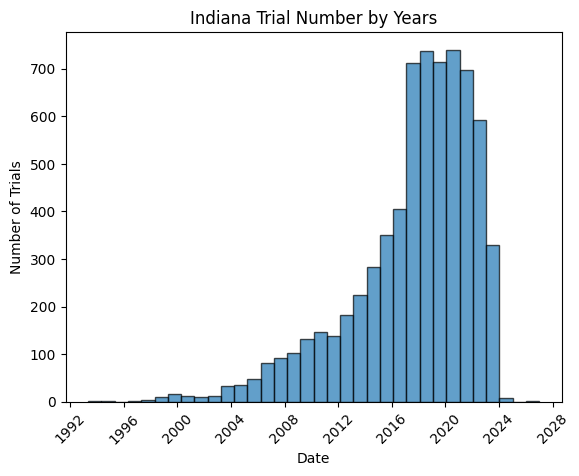

In [168]:
import matplotlib.pyplot as plt
plt.hist(start_dates_in, bins=34, edgecolor='k', alpha=0.7)
plt.xlabel('Date')
plt.ylabel('Number of Trials')
plt.title('Indiana Trial Number by Years')
plt.xticks(rotation=45)
plt.show()

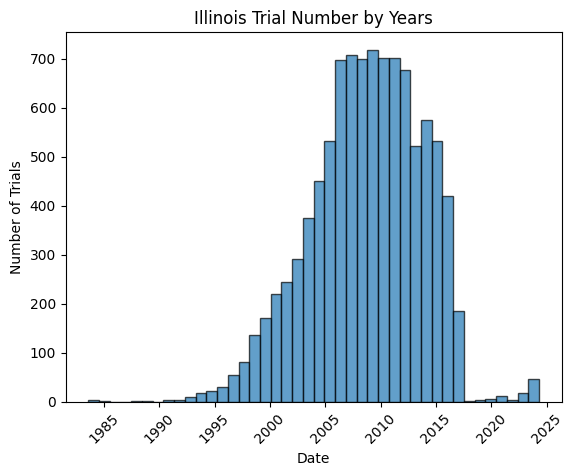

In [169]:
import matplotlib.pyplot as plt
plt.hist(start_dates_il, bins=42, edgecolor='k', alpha=0.7)
plt.xlabel('Date')
plt.ylabel('Number of Trials')
plt.title('Illinois Trial Number by Years')
plt.xticks(rotation=45)
plt.show()

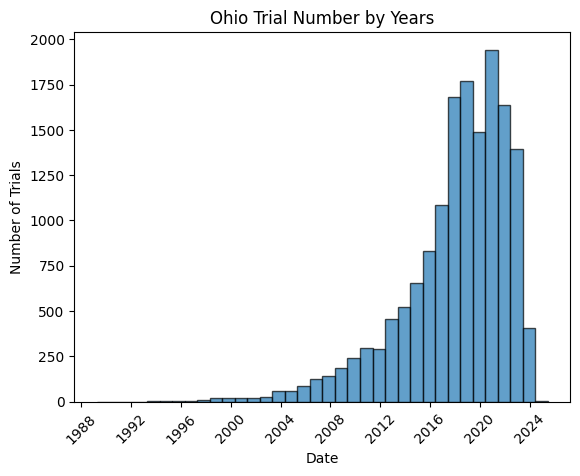

In [170]:
import matplotlib.pyplot as plt
plt.hist(start_dates_oh, bins=36, edgecolor='k', alpha=0.7)
plt.xlabel('Date')
plt.ylabel('Number of Trials')
plt.title('Ohio Trial Number by Years')
plt.xticks(rotation=45)
plt.show()

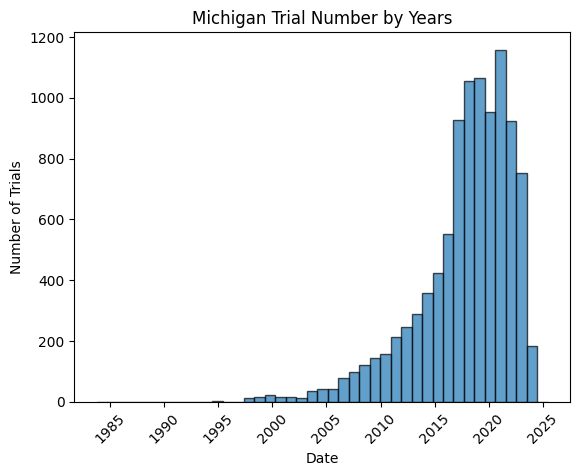

In [171]:
import matplotlib.pyplot as plt
plt.hist(start_dates_mi, bins=43, edgecolor='k', alpha=0.7)
plt.xlabel('Date')
plt.ylabel('Number of Trials')
plt.title('Michigan Trial Number by Years')
plt.xticks(rotation=45)
plt.show()

Below we cycle through each of the states of interest and print the change in number of trials for each year per the trial data.

In [118]:
from collections import Counter
# calculate the percent change in trail counts:

def trial_count_years(start_dates):
    year_counts = Counter(date.year for date in start_dates)

    sorted_years = sorted(year_counts.keys())
    
    percent_changes = {}
    for i in range(1, len(sorted_years)):
        current_year = sorted_years[i]
        previous_year = sorted_years[i - 1]

        count_current = year_counts[current_year]
        count_previous = year_counts[previous_year]

        percent_change = ((count_current - count_previous) / count_previous) * 100

        percent_changes[current_year] = percent_change

    data = {'Year': sorted_years, 'Count': [year_counts[year] for year in sorted_years]}
    data['Percent Change'] = [percent_changes.get(year, None) for year in sorted_years]

    df = pd.DataFrame(data)

    return df

percent_change_IN = trial_count_years(start_dates_in)
percent_change_OH = trial_count_years(start_dates_oh)
percent_change_IL = trial_count_years(start_dates_il)
percent_change_MI = trial_count_years(start_dates_mi)


In [119]:
percent_change_usa = trial_count_years(start_dates_us)

In [120]:
percent_change_usa

,Year,Count,Percent Change
0,1957,1,NaN
1,1966,1,0.000000
2,1971,1,0.000000
3,1972,2,100.000000
4,1975,1,-50.000000
5,1977,4,300.000000
6,1978,3,-25.000000
7,1979,1,-66.666667
8,1980,2,100.000000
9,1981,2,0.000000


In [121]:
percent_change_IN

,Year,Count,Percent Change
0,1977,2,NaN
1,1979,1,-50.000000
2,1984,1,0.000000
3,1986,1,0.000000
4,1987,2,100.000000
5,1988,1,-50.000000
6,1989,1,0.000000
7,1991,5,400.000000
8,1992,8,60.000000
9,1993,6,-25.000000


In [47]:
percent_change_OH

,Year,Count,Percent Change
0,1989,1,NaN
1,1993,1,0.000000
2,1994,3,200.000000
3,1995,3,0.000000
4,1996,1,-66.666667
5,1997,8,700.000000
6,1998,8,0.000000
7,1999,19,137.500000
8,2000,18,-5.263158
9,2001,20,11.111111


In [48]:
percent_change_IL

,Year,Count,Percent Change
0,1983,2,NaN
1,1984,1,-50.000000
2,1985,1,0.000000
3,1988,1,0.000000
4,1991,6,500.000000
5,1992,9,50.000000
6,1993,8,-11.111111
7,1994,27,237.500000
8,1995,25,-7.407407
9,1996,47,88.000000


In [49]:
percent_change_MI

,Year,Count,Percent Change
0,1983,1,NaN
1,1993,1,0.000000
2,1994,2,100.000000
3,1995,1,-50.000000
4,1997,8,700.000000
5,1998,12,50.000000
6,1999,23,91.666667
7,2000,18,-21.739130
8,2001,15,-16.666667
9,2002,10,-33.333333


In [50]:
percent_change_usa 

,Year,Count,Percent Change
0,1916,1,NaN
1,1963,1,0.000000
2,1973,1,0.000000
3,1975,1,0.000000
4,1976,4,300.000000
5,1977,6,50.000000
6,1978,2,-66.666667
7,1979,3,50.000000
8,1980,2,-33.333333
9,1981,1,-50.000000


## Healthcare facility data

One way to measure the Healthcare infrastructure in a state is to use data about the healthcare facilities. We were able to draw data form the Centers for Medicare and Medicaid Services shown at the top to populate facilities lists for each state. Interestingly, Indiana has roughly the same number of facilities as MI but less than IL and OH who each have close to 200.

In [85]:
hospitals_in = hospitals_us[hospitals_us['State'] == 'IN']
hospitals_oh = hospitals_us[hospitals_us['State'] == 'OH']
hospitals_il = hospitals_us[hospitals_us['State'] == 'IL']
hospitals_mi = hospitals_us[hospitals_us['State'] == 'MI']
print(hospitals_in.shape)
print(hospitals_oh.shape)
print(hospitals_il.shape)
print(hospitals_mi.shape)

(151, 38)
(197, 38)
(196, 38)
(150, 38)


In [53]:
hospitals_in.head()

,Facility ID,Facility Name,Address,City/Town,State,ZIP Code,County/Parish,Telephone Number,Hospital Type,Hospital Ownership,Emergency Services,Meets criteria for promoting interoperability of EHRs,Hospital overall rating,Hospital overall rating footnote,MORT Group Measure Count,Count of Facility MORT Measures,Count of MORT Measures Better,Count of MORT Measures No Different,Count of MORT Measures Worse,MORT Group Footnote,Safety Group Measure Count,Count of Facility Safety Measures,Count of Safety Measures Better,Count of Safety Measures No Different,Count of Safety Measures Worse,Safety Group Footnote,READM Group Measure Count,Count of Facility READM Measures,Count of READM Measures Better,Count of READM Measures No Different,Count of READM Measures Worse,READM Group Footnote,Pt Exp Group Measure Count,Count of Facility Pt Exp Measures,Pt Exp Group Footnote,TE Group Measure Count,Count of Facility TE Measures,TE Group Footnote
1488,150001,JOHNSON MEMORIAL HOSPITAL,1125 W JEFFERSON ST,FRANKLIN,IN,46131,JOHNSON,(317) 736-3300,Acute Care Hospitals,Government - Local,Yes,Y,4,NaN,7,4,0,4,0,NaN,8,3,1,2,0,NaN,11,7,1,6,0,NaN,8,8,NaN,12,12,NaN
1489,150002,METHODIST HOSPITALS INC,600 GRANT ST,GARY,IN,46402,LAKE,(219) 886-4000,Acute Care Hospitals,Voluntary non-profit - Private,Yes,Y,2,NaN,7,6,0,6,0,NaN,8,7,2,4,1,NaN,11,8,0,4,4,NaN,8,8,NaN,12,11,NaN
1490,150004,FRANCISCAN HEALTH HAMMOND,5454 HOHMAN AVE,HAMMOND,IN,46320,LAKE,(219) 932-2300,Acute Care Hospitals,Voluntary non-profit - Church,Yes,Y,2,NaN,7,5,0,5,0,NaN,8,4,0,3,1,NaN,11,8,0,4,4,NaN,8,8,NaN,12,8,NaN
1491,150005,HENDRICKS REGIONAL HEALTH,1000 E MAIN ST,DANVILLE,IN,46122,HENDRICKS,(317) 745-4451,Acute Care Hospitals,Government - Local,Yes,Y,5,NaN,7,6,0,6,0,NaN,8,8,0,8,0,NaN,11,10,0,10,0,NaN,8,8,NaN,12,12,NaN
1492,150006,NORTHWEST HEALTH-LA PORTE,1331 STATE STREET,LA PORTE,IN,46350,LA PORTE,(219) 326-1234,Acute Care Hospitals,Voluntary non-profit - Private,Yes,Y,2,NaN,7,6,0,6,0,NaN,8,6,0,6,0,NaN,11,10,0,10,0,NaN,8,8,NaN,12,10,NaN


As we see below, Indiana has fewer trials per Hospital at about 70 compared to about 100 for each of the other 3 states. This is another indicator of relatively lower trial participation in the state of Indiana.

In [54]:
print(f'The number of trials per hosptial in Indiana is {round(NIH_in.shape[0]/hospitals_in.shape[0], 2)}')
print(f'The number of trials per hosptial in Ohio is {round(NIH_oh.shape[0]/hospitals_oh.shape[0], 2)}')
print(f'The number of trials per hosptial in Illinois is {round(NIH_il.shape[0]/hospitals_il.shape[0], 2)}')
print(f'The number of trials per hosptial in Michigan is {round(NIH_mi.shape[0]/hospitals_mi.shape[0], 2)}')

The number of trials per hosptial in Indiana is 69.63
The number of trials per hosptial in Ohio is 101.5
The number of trials per hosptial in Illinois is 98.55
The number of trials per hosptial in Michigan is 103.73


In [86]:
save('backup_1', 'NIH_usa', 'NIH_in', 'NIH_rest', 'in_map', 'nih_usa_map', 'NIH_il', 'NIH_mi', 'NIH_oh','NIH_ky', 'hospitals_us')

In [3]:
load_pickle('backup_1')

## Conclusion

**Results**
This project has allowed us to shed light on the quantity and distribution of clinical trials in the US and specifically in Indiana. We have learned that Indiana is not a leading location in Clinical Trial participation, despite it's reputation as a center for life sciences. We see clearly that there is a specific type of trial in terms of funders where Indiana is lagging behind other states, the 'Other' funder type. This type includes large research Universities and other institutions and many of the trials are large collaborations with many sponsors and many trial locations. It seems that any major improvements to the basic infrastructure available to allow Indiana locations to participate in large complex research projects would help to increase the footprint of clinical trials in the state overall.

**Recommendations for Future Work**
Every good research question generates many more questions even as it answers some. This project is no exception. We believe the topic would be ripe for much more research to understand how Indiana can be a bigger player in the clinical trial space. Here are few of the recommendations:
1. More qualitative research on the clinical trials: There are many questions that may be able to be answered about who the actual trial participants are, what the methods of conducting trials involve and what limiting factors may exist that determine locations of trials.
2. More qualitative research of state that are ranked highly in the state list above: It's interesting the Kansas and Nebraska are ranked among the top 5 states in trials per capita. These states may hold additional answers to the questions regarding what may help Indiana to get more involved in the space. This topic was something we wanted to look into but just ran out of time for this particular project.
3. How have advancements in information technology effected the nature of trial participants: With advancements around remote communications, is it now more common for trial participants to be located remotely in relation to the study location. If so this could obviously change our understanding of the locations column in the data and effect our understanding of the economic impact of the trials.
4. Understanding the overall economic impact of clinical trials: Another area where we were interested in understanding but just were not able to identify good data sources by the deadline for the project with around this topic. We took it as an assumption that trials have a positive economic impact in a state, and that seems like a reasonable assumption but understanding the extent of this relationship and the overall scale of economic activity would be important for setting priorities and goals.